Rianur Rahman

In [1]:
import numpy as np
import scipy as sp
from scipy import io
import cv2 as cv 
import matplotlib.pyplot as plt
import pylab
import os # for reading all files in a folder
#pylab.rcParams['figure.figsize'] = (12.0, 10.0)

# Part H: Tracking and Homographies

In this part we use Practical 7c to track the positions of the four corners of the square and project a cube into the images. 

TO DO: QUESTIONS TO THINK ABOUT...

- Do the results look realistic? 
- If not then what factors do you think might be causing this


TO DO: your routines for computing a homography and extracting a valid rotation and translation go in the code below. Tips:
- you may define functions for T and H matrices respectively.
- you may need to turn the points into homogeneous form before any other computation. 
- you may need to solve a linear system in Ah = 0 form. Write your own routines or using the builtin function 'svd'. 
- you may apply the direct linear transform (DLT) algorithm to recover the best homography H.
- you may explain what & why you did in the report.


In [2]:
# TODO: Copy and paste the function HW2_Practical7c in here. 
#Likelihood function is simple patch similarity

def computeLikelihood(image, template):
    #opencv's available methods - experiment with these
    #careful what range the output is!
    methods = [cv.TM_CCOEFF, cv.TM_CCOEFF_NORMED, cv.TM_CCORR,
            cv.TM_CCORR_NORMED, cv.TM_SQDIFF, cv.TM_SQDIFF_NORMED]
    
    likelihood = cv.matchTemplate(image[:,:,2], template, methods[0])
    # (You can also try converting the image to greyscale instead of using the third channel as above with 
    # cv.cvtColor(image, cv.COLOR_BGR2GRAY))
    
    #we can pad to make this the size of the input image (for easier indexing)   
    pad_first = int(template.shape[0])
    pad_second = int(template.shape[1])
    pad_amounts = ((0, pad_first-1), (0, pad_second-1))
    likelihood = np.pad(likelihood, pad_amounts, 'constant')
    likelihood[likelihood<0] = 0 # to avoid negative weights 
    
    # apply a 10x10 averaging filter for stability. You can experiment with different sizes. 
    kernel = np.ones((10,10),np.float32)/100
    smoothed = cv.filter2D(likelihood,-1,kernel) 
    return smoothed 

def HW2_Practical7c(corner, plotRate=10):
    template = sp.io.loadmat(corner+'.mat')['pixelsTemplate']
    #let's show the template
    print('We are matching this template with shape: ', template.shape)
    plt.imshow(template)
    plt.show()

    # Load all images in folder
    images = []
    iFrame = 0
    folder = 'Pattern01/'
    lst = os.listdir(folder)
    lst.sort()

    for frameNum in lst:
        images.append(cv.imread(folder+frameNum))
        iFrame += 1
    # plot first image 
    plt.imshow(images[0])
    plt.show()

    imgHeight, imgWidth, colors = images[0].shape
    numParticles = 2000;
    weight_of_samples = np.ones((numParticles,1))

    # TODO: normalize the weights (may be trivial this time) [done]
    #weight_of_samples = weight_of_samples #replace this
    weight_of_samples = weight_of_samples/np.sum(weight_of_samples);

    # Initialize which samples from "last time" we want to propagate: all of
    # them!:
    samples_to_propagate = range(0, numParticles)


    # ============================
    # NOT A TODO: You don't need to change the code below, but eventually you may
    # want to vary the number of Dims (compare for example to lab 9b) 
    numDims_w = 2;
    #change
    #numDims_w = 4;
    # Here we randomly initialize some particles throughout the space of w:
    particles_old = np.random.rand(numParticles, numDims_w)
    particles_old[:,0] = particles_old[:,0] * imgHeight
    particles_old[:,1] = particles_old[:,1] * imgWidth

    # ============================

    #Initialize a temporary array r to store the per-frame MAP estimate of w. This is what we'll return in the end.
    r = np.zeros((iFrame, numDims_w));

    for iTime in range(iFrame):
        print('Processing Frame', iTime)
        # TODO: compute the cumulative sume of the weights. [done]
        #cum_hist_of_weights = np.linspace(0, 1, numParticles) # replace this
        cum_hist_of_weights =  np.cumsum(weight_of_samples);
        #print(weight_of_samples)


        # ==============================================================
        # Resample the old distribution at time t-1, and select samples, favoring
        # those that had a higher posterior probability.
        # ==============================================================
        samples_to_propagate = np.zeros(numParticles, dtype=np.int32)

        # Pick random thresholds in the cumulative probability's range [0,1]:
        some_threshes = np.random.rand(numParticles)


        # For each random threshold, find which sample in the ordered set is
        # the first one to push the cumulative probability above that
        # threshold, e.g. if the cumulative histogram goes from 0.23 to 0.26
        # between the 17th and 18th samples in the old distribution, and the
        # threshold is 0.234, then we'll want to propagate the 18th sample's w
        # (i.e. particle #18).

        for sampNum in range(numParticles): 
            thresh = some_threshes[sampNum]
            for index in range (numParticles):
                if cum_hist_of_weights[index] > thresh:
                    break
            samples_to_propagate[sampNum] = index

        # Note: it's ok if some of the old particles get picked repeatedly, while
        # others don't get picked at all.


        # =================================================
        # Visualize if you want
        # =================================================
        #plt.title('Cumulative histogram of probabilities for sorted list of particles')
        #plt.plot(np.zeros(numParticles), some_threshes,'b.')
        #plt.plot(range(0, numParticles), cum_hist_of_weights, 'rx-')
        #which_sample_ids = np.unique(samples_to_propagate)
        #how_many_of_each = np.bincount(np.ravel(samples_to_propagate))
        #for k in range(len(which_sample_ids)):
        #    plt.plot(which_sample_ids[k], 0, 'bo-', markersize = 3 * how_many_of_each[k], markerfacecolor='white')
        #plt.xlabel('Indeces of all available samples, with larger blue circles for frequently re-sampled particles\n(Iteration %01d)' % iTime)
        #plt.ylabel('Cumulative probability');
        #plt.show()
        # =================================================
        # =================================================

        # Predict where the particles we sampled from the old distribution of 
        # state-space will go in the next time-step. This means we have to apply 
        # the motion model to each old sample.
        particles_new = np.zeros_like(particles_old)
    
        for particleNum in range(numParticles):
            # TODO: Incorporate some noise, e.g. Gaussian noise with std 20,
            # into the current location (particles_old), to give a Brownian
            # motion model.
            particles_new[particleNum, :] =  particles_old[samples_to_propagate[particleNum], :] + np.random.normal(0,20, (numDims_w)) 
            

        # TODO: Not initially, but change the motion model above to have
        # different degrees of freedom, and optionally completely different
        # motion models. See Extra Credit for more instructions.

        #calculate likelihood function
        likelihood = computeLikelihood(images[iTime], template)
        

        if(iTime%plotRate==0):
            #plot results
            f, axarr = plt.subplots(1, 2)
            axarr[0].imshow(images[iTime])
            axarr[0].set_title('Particles')
            # now draw the particles onto the image
            axarr[0].plot(particles_new[:,1]+template.shape[1]/2, particles_new[:,0]+template.shape[0]/2, 'rx')

            #plot the likelihood
            axarr[1].imshow(likelihood)
            axarr[1].set_title('Likelihood')





        # From here we incorporate the data for the new state (time t):
        # The new particles accompanying predicted locations in state-space
        # for time t, are missing their weights: how well does each particle
        # explain the observations x_t?
        for particleNum in range(numParticles):

            # Convert the particle from state-space w to measurement-space x:
            # Note: that step is trivial here since both are in 2D space of image
            # coordinates

            # Within the loop, we evaluate the likelihood of each particle:
            particle = particles_new[particleNum, :]
            # Check that the predicted location is a place we can really evaluate
            # the likelihood.
            inFrame = particle[0] >= 0.0 and  particle[0] <= imgHeight and particle[1] >= 0.0 and particle[1] <= imgWidth
            if inFrame:
                minX = particle[1]
                minY = particle[0]

                weight_of_samples[particleNum] = likelihood[int(minY), int(minX)]

            else:
                weight_of_samples[particleNum] = 0.0

        # TODO: normalize the weights [done]
        weight_of_samples = weight_of_samples/np.sum(weight_of_samples); # replace this
        
        # find the location of the particle with highest weight
        indices = np.argsort(weight_of_samples,0)
        bestScoringParticles = particles_new[np.squeeze(indices[-15:]), :]
        if(iTime%plotRate==0):
            plt.plot(bestScoringParticles[-1:,1], bestScoringParticles[-1:,0], 'rx')
        # Return the MAP of middle position. Add template.shape/2 because matchTemplate finds the position of the upper left corner 
        # of the template. We want to plot the centre of the template. 
        r[iTime,:] = bestScoringParticles[-1,1]+template.shape[1]/2,bestScoringParticles[-1,0]+template.shape[0]/2
        print(r[iTime,:]) 
        if(iTime%plotRate==0):  
            plt.show()

            #print the original image and the position of the tracked corner.
            plt.imshow(images[iTime])
            plt.plot(r[iTime,0],r[iTime,1],'rx')
            plt.show()
        # Now we're done updating the state for time t. 
        # For Condensation, just clean up and prepare for the next round of 
        # predictions and measurements:
        particles_old = particles_new

    return r

I was having memory and rendering issues thus I added the variable plotRate which by default is set to 10, and decides how often (every how many frames) we plot the results. This can be set to 1 to display all the plots or a higher number to plot the results less often

In [3]:
np.random.seed(7)#random seed for repeatability

We are matching this template with shape:  (25, 28)


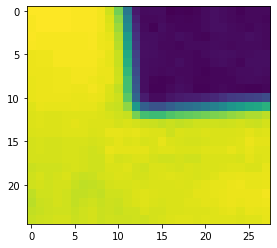

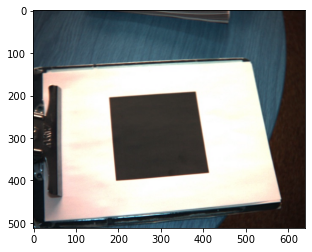

Processing Frame 0
[314.63057473 392.99610597]


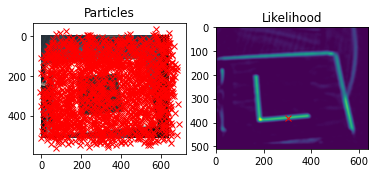

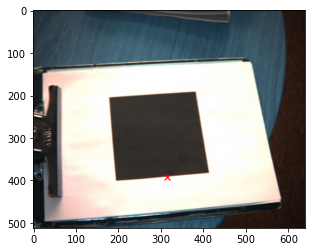

Processing Frame 1
[197.01528695 401.70557723]
Processing Frame 2
[198.58095896 402.21843197]
Processing Frame 3
[204.64049694 401.59202513]
Processing Frame 4
[203.94456155 403.9957643 ]
Processing Frame 5
[204.15390948 400.80673077]
Processing Frame 6
[207.60410349 400.9715542 ]
Processing Frame 7
[212.30084032 399.59405669]
Processing Frame 8
[210.87007273 401.04423661]
Processing Frame 9
[211.56630917 401.99791767]
Processing Frame 10
[210.04143222 402.65891648]


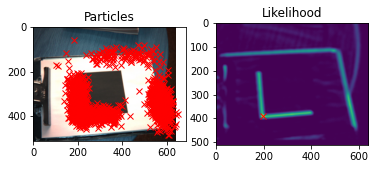

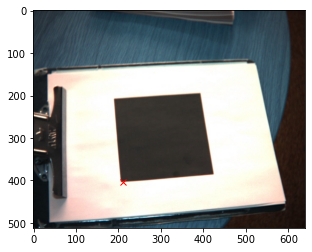

Processing Frame 11
[209.66236713 402.91143177]
Processing Frame 12
[210.28615648 403.96030971]
Processing Frame 13
[211.74310138 395.16379803]
Processing Frame 14
[220.71897965 390.86976048]
Processing Frame 15
[223.28624679 385.8727243 ]
Processing Frame 16
[225.11037548 383.74107731]
Processing Frame 17
[227.83659906 383.47292765]
Processing Frame 18
[232.16777422 382.90551631]
Processing Frame 19
[235.57492023 384.1250804 ]
Processing Frame 20
[236.423797   388.23817683]


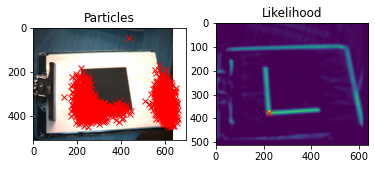

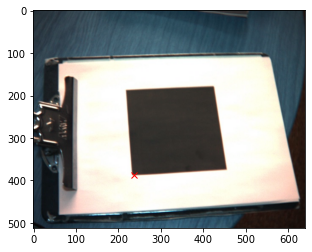

Processing Frame 21
[239.03822269 390.79119096]
Processing Frame 22
[242.02647943 394.00164782]
Processing Frame 23
[250.84900363 395.25234379]
Processing Frame 24
[254.18315891 397.24480237]
Processing Frame 25
[257.70756037 397.47054865]
Processing Frame 26
[262.00993639 396.24106561]
Processing Frame 27
[270.37121727 391.99767766]
Processing Frame 28
[276.51360103 392.7547074 ]
Processing Frame 29
[282.43456093 395.78739495]
Processing Frame 30
[281.18884729 403.79006953]


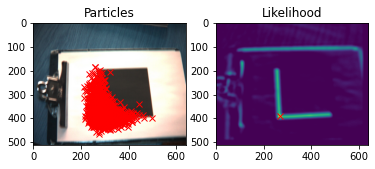

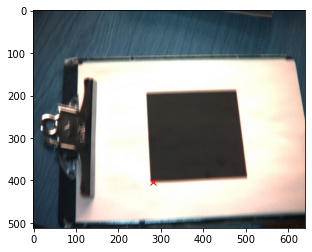

Processing Frame 31
[279.96349431 413.50700502]
Processing Frame 32
[278.4586191  419.31930909]
Processing Frame 33
[279.15414587 426.03511571]
Processing Frame 34
[271.66169874 430.41767844]
Processing Frame 35
[264.07069278 432.87370549]
Processing Frame 36
[255.66750584 428.38020442]
Processing Frame 37
[244.73862818 427.06700147]
Processing Frame 38
[223.53782889 421.58384038]
Processing Frame 39
[206.19763341 431.43238072]
Processing Frame 40
[190.42478411 441.62567237]


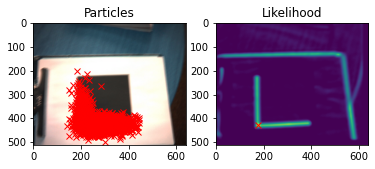

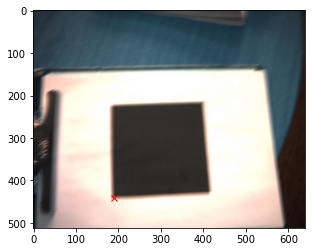

Processing Frame 41
[186.39139739 452.24124882]
Processing Frame 42
[177.11351857 463.01125631]
Processing Frame 43
[165.02102211 476.01186105]
Processing Frame 44
[168.10914625 483.68091498]
Processing Frame 45
[168.33460582 492.72667781]
Processing Frame 46
[170.02328182 492.70536762]
Processing Frame 47
[169.81661781 490.17188188]
Processing Frame 48
[170.60587115 480.72659056]
Processing Frame 49
[174.75052495 472.18096655]
Processing Frame 50
[178.13139203 464.21350963]


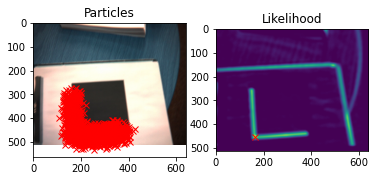

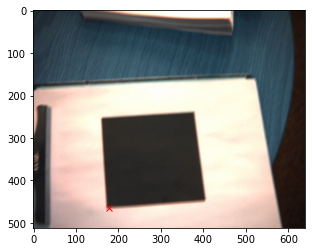

Processing Frame 51
[179.27226856 457.41022478]
Processing Frame 52
[179.66366655 460.39992887]
Processing Frame 53
[178.97339421 464.27501792]
Processing Frame 54
[178.58516895 468.4886049 ]
Processing Frame 55
[172.08202155 471.14078762]
Processing Frame 56
[171.47436964 465.12212741]
Processing Frame 57
[173.76080388 456.48127798]
Processing Frame 58
[173.13197406 444.52328458]
Processing Frame 59
[173.69059952 431.12039401]
Processing Frame 60
[173.42096504 421.25461632]


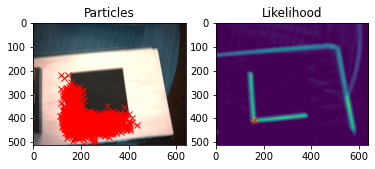

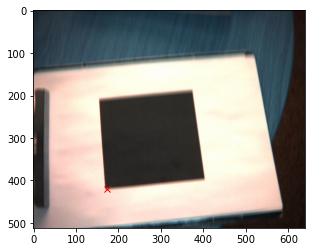

Processing Frame 61
[172.07770305 412.2901004 ]
Processing Frame 62
[172.82454027 410.3901575 ]
Processing Frame 63
[170.69385697 408.67063414]
Processing Frame 64
[173.39809813 406.76998913]
Processing Frame 65
[172.66466753 406.15370959]
Processing Frame 66
[169.59681697 405.26687516]
Processing Frame 67
[169.83006987 402.99373796]
Processing Frame 68
[168.82435197 400.85895534]
Processing Frame 69
[169.01711494 397.9947979 ]
Processing Frame 70
[168.74455588 398.07321464]


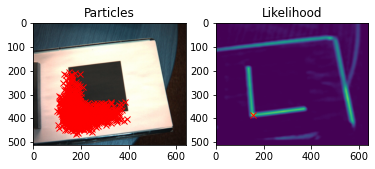

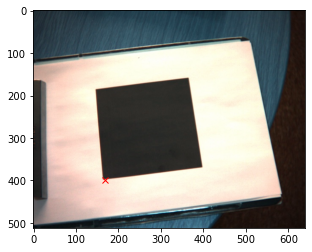

Processing Frame 71
[169.33133692 395.72865384]
Processing Frame 72
[169.15347096 392.53365922]
Processing Frame 73
[170.63130821 392.73624217]
Processing Frame 74
[172.98318425 394.36337577]
Processing Frame 75
[177.40522979 399.79098212]
Processing Frame 76
[185.23173013 402.54841956]
Processing Frame 77
[203.24862208 393.77361886]
Processing Frame 78
[213.60953688 387.33327482]
Processing Frame 79
[219.59653999 377.51672123]
Processing Frame 80
[223.92790136 367.04047834]


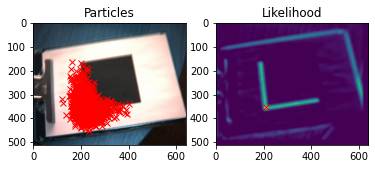

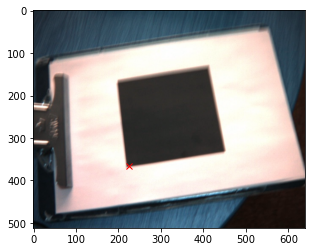

Processing Frame 81
[224.18590028 361.72734711]
Processing Frame 82
[224.14137562 358.92106948]
Processing Frame 83
[223.68987422 357.11201457]
Processing Frame 84
[224.76574926 353.29870523]
Processing Frame 85
[224.95399792 353.48696093]
Processing Frame 86
[219.21224288 354.25827378]
Processing Frame 87
[216.60437637 351.1168054 ]
Processing Frame 88
[212.50931017 348.57370388]
Processing Frame 89
[210.11780507 348.40857967]
Processing Frame 90
[208.80636745 343.51545653]


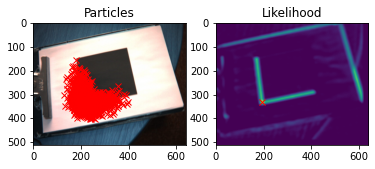

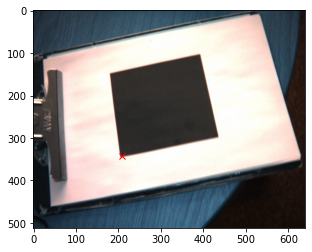

Processing Frame 91
[208.05644717 344.37561654]
Processing Frame 92
[209.76906832 340.75384247]
Processing Frame 93
[211.07250242 336.82451697]
Processing Frame 94
[211.00340543 336.45170822]
Processing Frame 95
[213.89968657 332.63271645]
Processing Frame 96
[207.37191963 338.4725777 ]
Processing Frame 97
[194.45454393 348.25817671]
Processing Frame 98
[188.06621501 349.23192957]
Processing Frame 99
[183.4705544  355.65548131]
Processing Frame 100
[176.81490905 365.37751859]


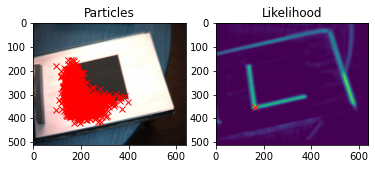

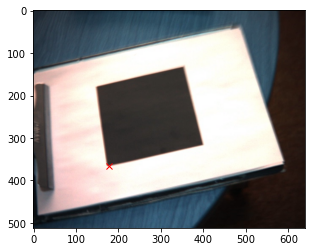

Processing Frame 101
[174.81200482 365.99345252]
Processing Frame 102
[168.12601908 360.53763097]
Processing Frame 103
[172.81522139 350.84609848]
Processing Frame 104
[171.02079083 345.77062667]
Processing Frame 105
[162.6828684  339.70760976]
Processing Frame 106
[169.89683614 336.56807618]
Processing Frame 107
[169.71726852 332.34378978]
Processing Frame 108
[167.18581276 332.0095826 ]
Processing Frame 109
[166.3533073  331.55830431]
Processing Frame 110
[156.8278894  333.54279828]


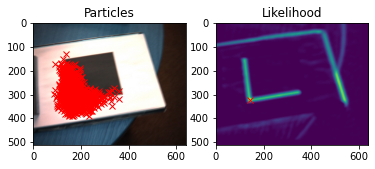

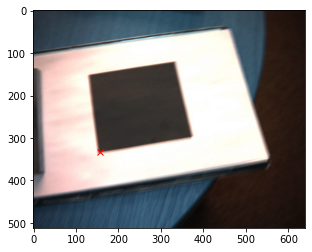

Processing Frame 111
[150.78611484 344.43621874]
Processing Frame 112
[145.26391307 350.5587551 ]
Processing Frame 113
[145.38485443 354.0922359 ]
Processing Frame 114
[147.62889959 356.76487816]
Processing Frame 115
[151.26967995 360.49967075]
Processing Frame 116
[157.03668272 360.71090029]
Processing Frame 117
[160.78661557 365.31425658]
Processing Frame 118
[167.57916316 363.91238826]
Processing Frame 119
[177.35119609 361.22196114]
Processing Frame 120
[183.77062025 365.17668342]


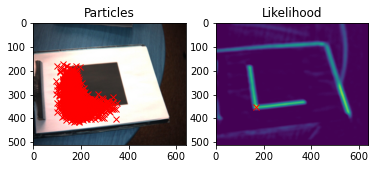

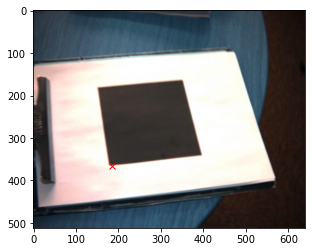

Processing Frame 121
[185.80881139 363.11547129]
Processing Frame 122
[190.19322214 357.89067034]
Processing Frame 123
[191.23934881 355.57360255]
Processing Frame 124
[186.47111237 360.40023328]
Processing Frame 125
[185.16334185 358.89604008]
Processing Frame 126
[193.59777467 354.26932488]
Processing Frame 127
[199.21020074 353.18838183]
Processing Frame 128
[203.87227047 356.44953651]
Processing Frame 129
[205.46247532 357.28129522]
Processing Frame 130
[198.93966517 360.87695656]


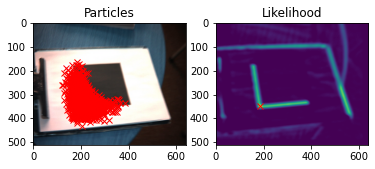

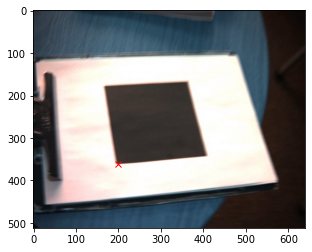

Processing Frame 131
[188.5092215  355.97226497]
Processing Frame 132
[184.29439488 344.53319678]
Processing Frame 133
[186.78235913 337.98169136]
Processing Frame 134
[184.89119182 330.63552394]
Processing Frame 135
[189.13162052 325.9922502 ]
Processing Frame 136
[190.15346834 320.41070605]
Processing Frame 137
[191.06568131 316.05341287]
Processing Frame 138
[191.20187061 313.8222758 ]
Processing Frame 139
[198.59562413 311.12004512]
Processing Frame 140
[201.80867341 309.67890918]


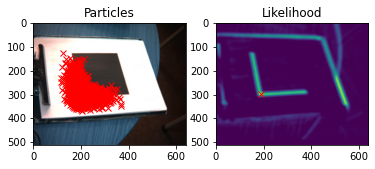

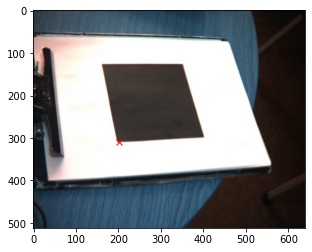

Processing Frame 141
[199.71301952 313.14806903]
Processing Frame 142
[198.47556486 309.31118641]
Processing Frame 143
[193.68808435 310.04897665]
Processing Frame 144
[186.17989894 313.36495778]
Processing Frame 145
[181.07763824 303.96125503]
Processing Frame 146
[177.70648818 303.70372937]
Processing Frame 147
[172.59164223 311.59244553]
Processing Frame 148
[167.4319575  313.33175073]
Processing Frame 149
[170.58874913 315.66991859]
Processing Frame 150
[168.44551702 314.23202471]


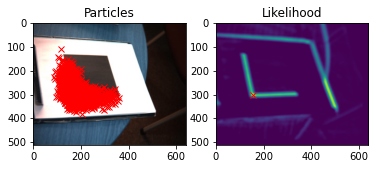

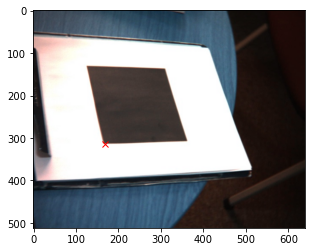

In [4]:
# instead of running the code here, you can also save the output of each function in a numpy array in HW2_Practical7c 
# and load it here. This could be handy if you need different hyperparameters for each corner.

LLs = HW2_Practical7c( 'll', plotRate=10 )


We are matching this template with shape:  (29, 29)


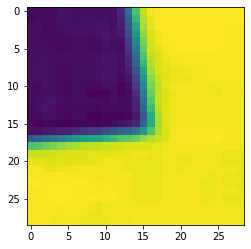

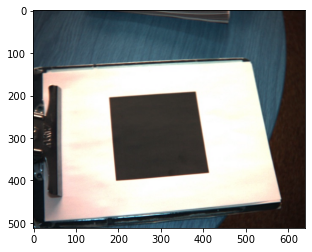

Processing Frame 0
[412.26612382 380.1670148 ]


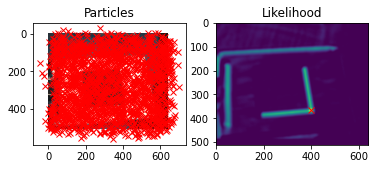

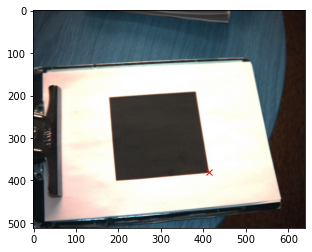

Processing Frame 1
[409.84975646 381.44836542]
Processing Frame 2
[410.98849883 381.67177193]
Processing Frame 3
[414.16034374 381.89932865]
Processing Frame 4
[418.24989296 384.69763263]
Processing Frame 5
[418.14552499 380.0468832 ]
Processing Frame 6
[420.0757888  380.22886127]
Processing Frame 7
[422.18636508 382.21646485]
Processing Frame 8
[421.50906281 382.0055211 ]
Processing Frame 9
[423.99712487 383.46750569]
Processing Frame 10
[422.80264362 383.90492833]


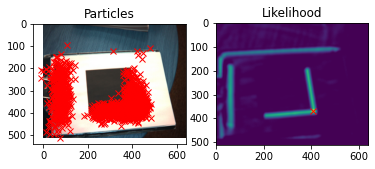

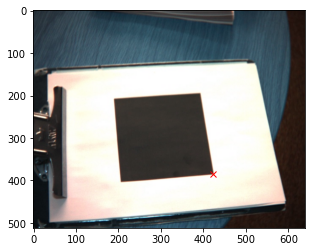

Processing Frame 11
[421.85222963 383.52480072]
Processing Frame 12
[422.0000779  383.70065571]
Processing Frame 13
[427.46910426 376.45163148]
Processing Frame 14
[431.90810019 371.97264229]
Processing Frame 15
[436.26809089 366.86569495]
Processing Frame 16
[439.02550688 364.63205866]
Processing Frame 17
[441.69912497 366.20049706]
Processing Frame 18
[445.50238698 365.8299968 ]
Processing Frame 19
[451.40027729 367.92809274]
Processing Frame 20
[453.62475744 373.46630647]


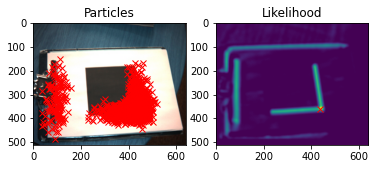

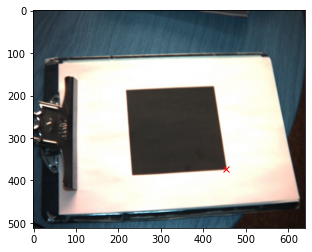

Processing Frame 21
[456.88193844 376.2754116 ]
Processing Frame 22
[460.69023828 380.64189068]
Processing Frame 23
[467.7686891  378.98398525]
Processing Frame 24
[471.37527591 381.88492847]
Processing Frame 25
[474.36707407 382.76109596]
Processing Frame 26
[480.84763718 381.98651309]
Processing Frame 27
[489.39892387 379.3373572 ]
Processing Frame 28
[496.5127411  379.31835894]
Processing Frame 29
[500.76208486 381.62155648]
Processing Frame 30
[501.83956424 390.90290852]


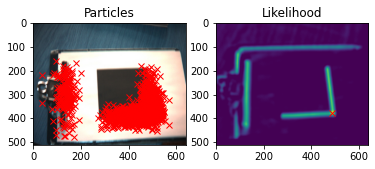

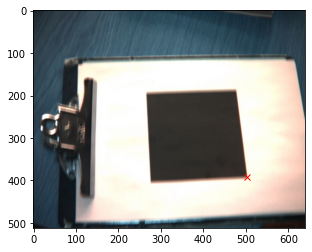

Processing Frame 31
[500.90123336 400.84520439]
Processing Frame 32
[501.30947462 406.86629385]
Processing Frame 33
[502.23742196 414.24399765]
Processing Frame 34
[494.91853999 417.93826686]
Processing Frame 35
[488.33215488 422.22649382]
Processing Frame 36
[478.68547649 417.44074856]
Processing Frame 37
[460.99117256 412.89597551]
Processing Frame 38
[446.60283813 408.65929732]
Processing Frame 39
[430.49868389 417.97422021]
Processing Frame 40
[416.74142554 426.22594915]


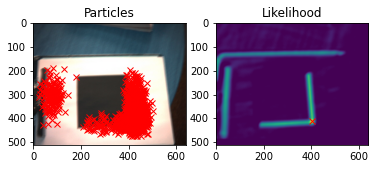

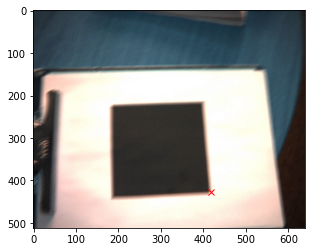

Processing Frame 41
[410.30518069 437.2651581 ]
Processing Frame 42
[401.73105574 446.63499289]
Processing Frame 43
[392.72884653 460.30267084]
Processing Frame 44
[390.54368798 468.95769405]
Processing Frame 45
[393.27652645 477.13241252]
Processing Frame 46
[396.13737811 476.19941964]
Processing Frame 47
[397.41429404 470.54886468]
Processing Frame 48
[397.63595434 462.51432413]
Processing Frame 49
[400.57007988 453.59781588]
Processing Frame 50
[404.03356035 446.22304246]


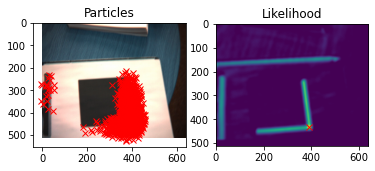

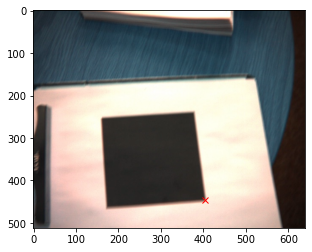

Processing Frame 51
[406.01901598 439.40067571]
Processing Frame 52
[405.83030064 441.01624563]
Processing Frame 53
[405.00757555 443.60325066]
Processing Frame 54
[404.84895235 447.76385325]
Processing Frame 55
[400.16808808 448.93616022]
Processing Frame 56
[398.98542662 447.31148314]
Processing Frame 57
[401.46972524 433.8112071 ]
Processing Frame 58
[401.75681132 422.85343536]
Processing Frame 59
[402.65294783 406.70564713]
Processing Frame 60
[401.58986423 396.41449927]


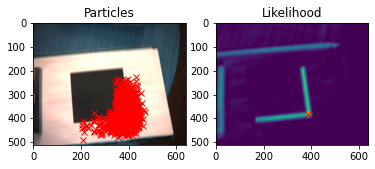

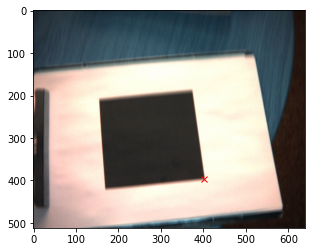

Processing Frame 61
[403.00368494 387.5324832 ]
Processing Frame 62
[400.56839716 384.88076986]
Processing Frame 63
[399.92737512 383.1929166 ]
Processing Frame 64
[399.60684721 379.52320879]
Processing Frame 65
[401.00783486 377.51454806]
Processing Frame 66
[398.72229836 378.34416544]
Processing Frame 67
[396.64528146 373.7365175 ]
Processing Frame 68
[398.32148033 372.38874267]
Processing Frame 69
[397.42960678 369.33977454]
Processing Frame 70
[395.61788823 367.62276625]


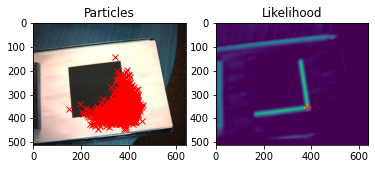

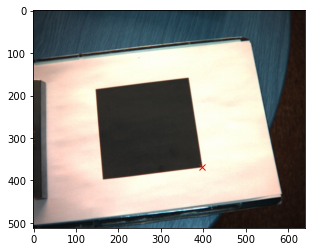

Processing Frame 71
[396.02821397 365.98617013]
Processing Frame 72
[396.91215708 361.80988019]
Processing Frame 73
[398.3226403  363.02401261]
Processing Frame 74
[400.30370616 364.59402249]
Processing Frame 75
[403.51994605 369.3028284 ]
Processing Frame 76
[407.67185929 369.73962757]
Processing Frame 77
[423.22833516 361.59397159]
Processing Frame 78
[439.34558197 353.89291096]
Processing Frame 79
[444.08758632 343.64350489]
Processing Frame 80
[449.75204819 330.97306117]


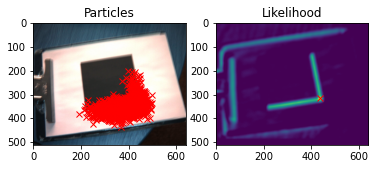

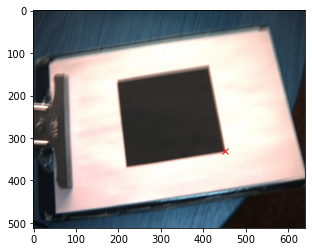

Processing Frame 81
[453.17824761 325.51792092]
Processing Frame 82
[452.20901006 320.76634093]
Processing Frame 83
[452.02749721 316.79662126]
Processing Frame 84
[451.54158458 312.25428771]
Processing Frame 85
[452.44717377 309.77444625]
Processing Frame 86
[446.10455573 308.96781913]
Processing Frame 87
[443.18730358 308.75520229]
Processing Frame 88
[439.98051092 303.33355057]
Processing Frame 89
[433.6861187  303.20908876]
Processing Frame 90
[432.94339504 299.17167073]


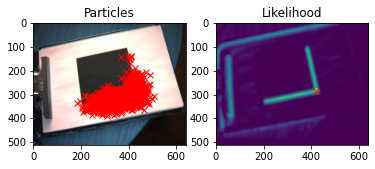

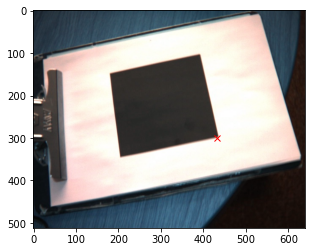

Processing Frame 91
[434.52495182 296.49124357]
Processing Frame 92
[433.99170782 292.66774346]
Processing Frame 93
[433.85540997 287.97568858]
Processing Frame 94
[435.16780394 284.17870995]
Processing Frame 95
[436.9523155 281.521353 ]
Processing Frame 96
[429.62113262 288.45073929]
Processing Frame 97
[415.65202633 296.79884927]
Processing Frame 98
[409.23490822 297.87807424]
Processing Frame 99
[404.36254594 305.25817631]
Processing Frame 100
[395.52116726 315.54630808]


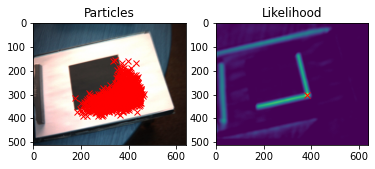

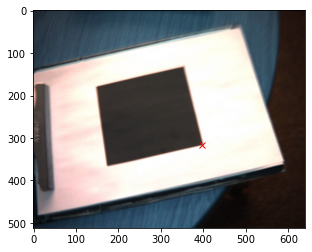

Processing Frame 101
[391.9336084 317.127133 ]
Processing Frame 102
[387.69653399 316.32058889]
Processing Frame 103
[390.17883548 308.47149531]
Processing Frame 104
[390.35252364 304.36993377]
Processing Frame 105
[380.59533018 298.70621857]
Processing Frame 106
[386.331388   295.84910915]
Processing Frame 107
[387.10781762 294.04244097]
Processing Frame 108
[384.81693065 293.33268329]
Processing Frame 109
[381.49458832 294.99237285]
Processing Frame 110
[372.45047862 298.63649877]


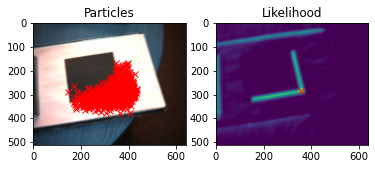

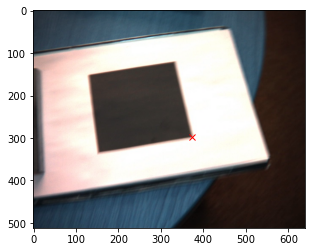

Processing Frame 111
[365.33821635 308.96778407]
Processing Frame 112
[359.94882822 319.3883957 ]
Processing Frame 113
[359.04731737 322.19318674]
Processing Frame 114
[361.39021478 325.35205558]
Processing Frame 115
[364.20024414 331.34090554]
Processing Frame 116
[371.31162055 330.7003148 ]
Processing Frame 117
[372.64111135 337.84152386]
Processing Frame 118
[378.46067883 337.56603531]
Processing Frame 119
[387.75671286 335.41906826]
Processing Frame 120
[395.17438796 339.36001801]


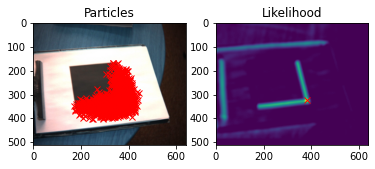

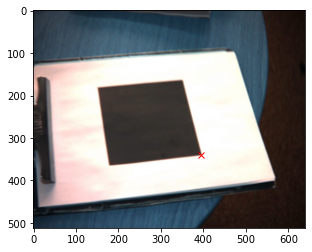

Processing Frame 121
[397.12529364 339.83989872]
Processing Frame 122
[400.4330924  337.14312202]
Processing Frame 123
[401.69000998 333.25068764]
Processing Frame 124
[399.01075641 336.73475826]
Processing Frame 125
[396.96546559 336.38656163]
Processing Frame 126
[404.25492986 333.12965194]
Processing Frame 127
[408.88197984 333.15001947]
Processing Frame 128
[410.9027218  336.00767875]
Processing Frame 129
[413.45251556 337.03019019]
Processing Frame 130
[404.72076178 341.33513908]


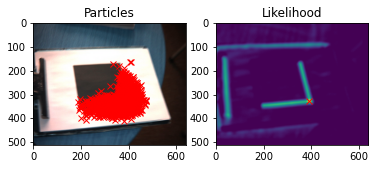

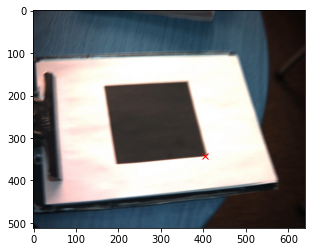

Processing Frame 131
[395.24913164 338.80634324]
Processing Frame 132
[389.76706813 327.97039353]
Processing Frame 133
[392.43903374 318.82472967]
Processing Frame 134
[388.14765064 315.42942658]
Processing Frame 135
[390.06874762 309.09669434]
Processing Frame 136
[391.74982282 304.3546943 ]
Processing Frame 137
[392.21364811 300.70681256]
Processing Frame 138
[391.17279548 300.18433106]
Processing Frame 139
[398.25153677 296.37242794]
Processing Frame 140
[399.04519823 295.52852519]


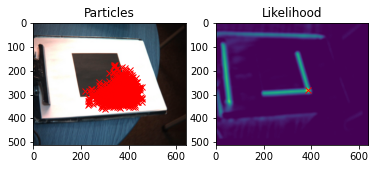

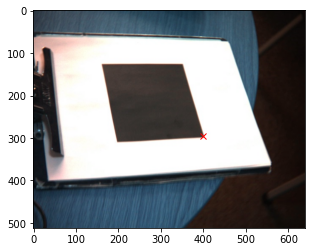

Processing Frame 141
[397.82015342 302.3276858 ]
Processing Frame 142
[394.8577094  296.62424668]
Processing Frame 143
[389.01953954 298.36605185]
Processing Frame 144
[380.80004802 303.36420545]
Processing Frame 145
[377.35253849 292.67526832]
Processing Frame 146
[370.83246264 292.02581144]
Processing Frame 147
[366.42432738 301.04996313]
Processing Frame 148
[358.58687602 303.48272353]
Processing Frame 149
[361.07027917 306.34439229]
Processing Frame 150
[358.62679398 305.37413492]


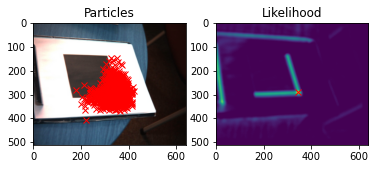

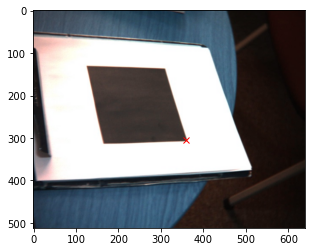

In [5]:

LRs = HW2_Practical7c( 'lr', plotRate=10)


We are matching this template with shape:  (25, 28)


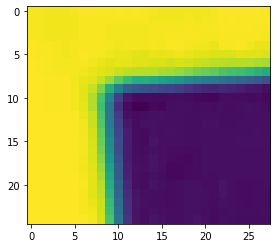

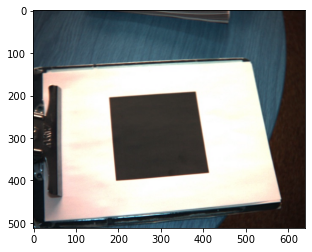

Processing Frame 0
[186.19097948 209.10909643]


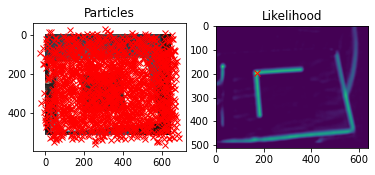

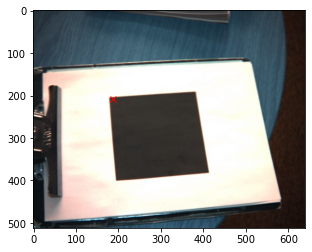

Processing Frame 1
[186.59513376 208.6244267 ]
Processing Frame 2
[185.97664851 208.40974141]
Processing Frame 3
[186.01891048 212.00439676]
Processing Frame 4
[189.20315843 214.43551069]
Processing Frame 5
[189.35492199 212.14284365]
Processing Frame 6
[189.62211738 211.11698935]
Processing Frame 7
[195.36747629 209.97506174]
Processing Frame 8
[196.08705131 211.19448883]
Processing Frame 9
[197.20068546 210.72263256]
Processing Frame 10
[197.58303759 211.29825096]


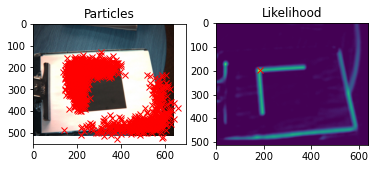

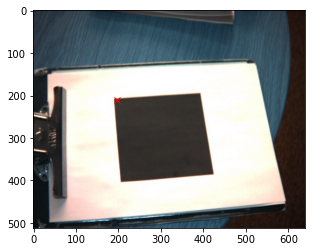

Processing Frame 11
[194.76027851 213.99686103]
Processing Frame 12
[195.94847152 213.25899355]
Processing Frame 13
[197.92130936 213.38737596]
Processing Frame 14
[203.40333286 202.4289032 ]
Processing Frame 15
[206.63007336 197.76461738]
Processing Frame 16
[211.36594872 190.35520148]
Processing Frame 17
[211.0345827  191.53557835]
Processing Frame 18
[216.00980625 192.29749956]
Processing Frame 19
[221.04310407 189.66618104]
Processing Frame 20
[224.07761789 194.38025225]


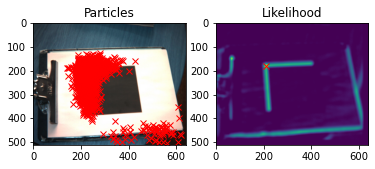

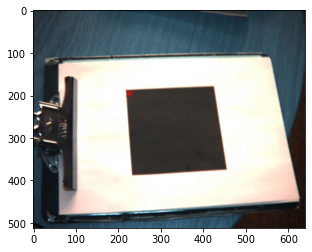

Processing Frame 21
[227.90679238 194.14075525]
Processing Frame 22
[231.56454952 199.48205496]
Processing Frame 23
[236.32833607 198.38573988]
Processing Frame 24
[240.17014734 198.09763915]
Processing Frame 25
[244.03881095 199.74447816]
Processing Frame 26
[251.30602857 199.82743611]
Processing Frame 27
[256.6226159  196.17946611]
Processing Frame 28
[266.17146588 193.42427993]
Processing Frame 29
[271.4920839  194.37353519]
Processing Frame 30
[273.58956124 199.96631032]


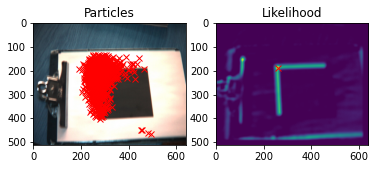

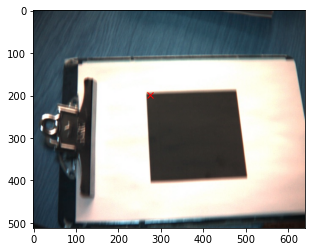

Processing Frame 31
[272.76001618 207.58186139]
Processing Frame 32
[270.18859121 213.63097106]
Processing Frame 33
[271.2929187  221.13143413]
Processing Frame 34
[269.47973296 226.03945357]
Processing Frame 35
[261.00616218 228.2438314 ]
Processing Frame 36
[251.2380205  226.16190274]
Processing Frame 37
[238.52452423 220.18838865]
Processing Frame 38
[218.48952412 217.16218654]
Processing Frame 39
[204.28748539 220.60474812]
Processing Frame 40
[187.83946363 228.37785887]


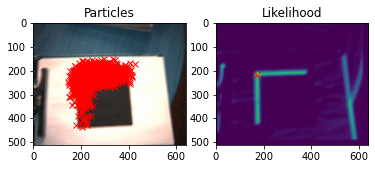

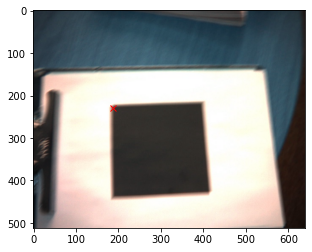

Processing Frame 41
[181.69305824 238.20312663]
Processing Frame 42
[174.51848378 247.20214453]
Processing Frame 43
[164.91930689 261.0305876 ]
Processing Frame 44
[159.80044319 272.97174449]
Processing Frame 45
[158.20787173 280.26433537]
Processing Frame 46
[158.11091842 282.76400467]
Processing Frame 47
[162.33762681 279.82099868]
Processing Frame 48
[162.4701963  274.93545883]
Processing Frame 49
[163.58162527 266.50187739]
Processing Frame 50
[166.20107776 257.32282891]


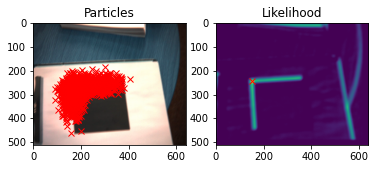

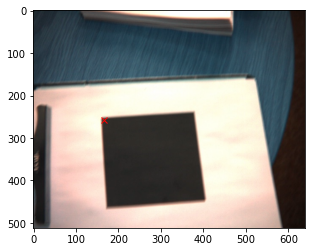

Processing Frame 51
[169.37814647 251.11381307]
Processing Frame 52
[170.95253732 248.41666553]
Processing Frame 53
[168.68830996 252.64793412]
Processing Frame 54
[168.09117328 254.50492715]
Processing Frame 55
[164.02148441 260.8513094 ]
Processing Frame 56
[162.35124914 260.05207659]
Processing Frame 57
[161.15932915 252.4558291 ]
Processing Frame 58
[162.23165719 240.60637894]
Processing Frame 59
[160.84435226 230.16533239]
Processing Frame 60
[159.00349086 214.06351749]


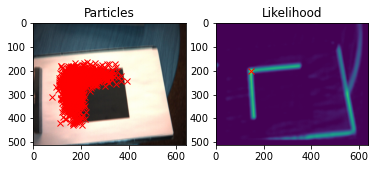

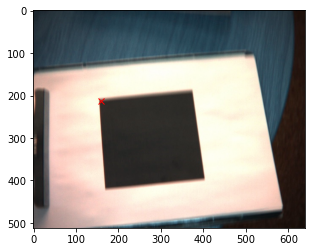

Processing Frame 61
[159.50660492 204.57983708]
Processing Frame 62
[160.61621569 201.45432395]
Processing Frame 63
[157.53987981 200.32049574]
Processing Frame 64
[158.56245654 197.61422414]
Processing Frame 65
[159.23861427 195.86041626]
Processing Frame 66
[156.4871635  196.21504356]
Processing Frame 67
[156.16720349 193.58770721]
Processing Frame 68
[154.94926033 193.90993809]
Processing Frame 69
[154.84236027 190.67293762]
Processing Frame 70
[154.11758679 188.92091986]


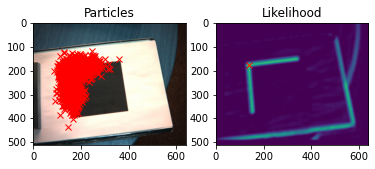

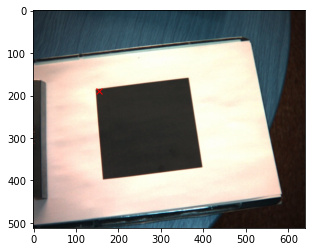

Processing Frame 71
[153.63703369 189.47045823]
Processing Frame 72
[153.14525638 187.66467658]
Processing Frame 73
[155.23680168 187.30543234]
Processing Frame 74
[155.19139839 189.64764111]
Processing Frame 75
[159.32644714 192.82582896]
Processing Frame 76
[166.01190081 197.93265816]
Processing Frame 77
[182.84343502 195.0351579 ]
Processing Frame 78
[194.44357115 188.0981646 ]
Processing Frame 79
[200.49456825 182.09882821]
Processing Frame 80
[204.57910095 169.6887097 ]


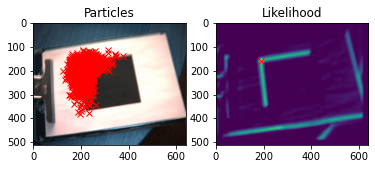

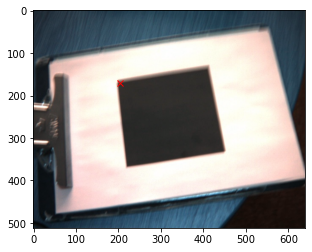

Processing Frame 81
[206.13367017 162.63326586]
Processing Frame 82
[204.41816288 159.70459183]
Processing Frame 83
[204.17954537 158.56430212]
Processing Frame 84
[203.46039884 155.71711482]
Processing Frame 85
[203.60503787 155.27496003]
Processing Frame 86
[201.63354111 155.71318382]
Processing Frame 87
[196.81606661 157.24646658]
Processing Frame 88
[194.58456093 153.51330928]
Processing Frame 89
[187.62763232 153.30049998]
Processing Frame 90
[186.08506685 150.70163634]


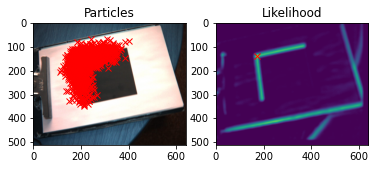

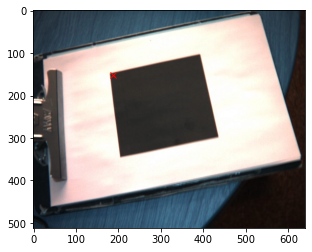

Processing Frame 91
[186.67831672 150.3508206 ]
Processing Frame 92
[186.902382   149.60785001]
Processing Frame 93
[188.02911625 144.8073009 ]
Processing Frame 94
[188.72124126 146.07795321]
Processing Frame 95
[188.04530693 142.51608388]
Processing Frame 96
[186.7312373  148.09210994]
Processing Frame 97
[172.25416448 159.74613727]
Processing Frame 98
[166.09953764 163.47231817]
Processing Frame 99
[159.14597334 168.93270062]
Processing Frame 100
[154.03835687 182.82243093]


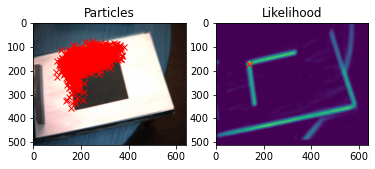

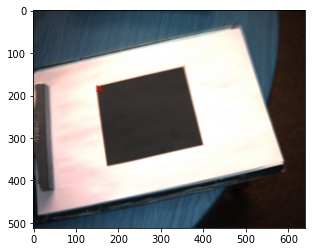

Processing Frame 101
[150.999699   183.30664037]
Processing Frame 102
[147.46646044 184.34397169]
Processing Frame 103
[147.02776637 173.8059473 ]
Processing Frame 104
[151.22123824 168.59184025]
Processing Frame 105
[141.74586446 168.81157713]
Processing Frame 106
[146.9733839  159.55733347]
Processing Frame 107
[147.87881865 156.30263271]
Processing Frame 108
[144.02280723 153.8120609 ]
Processing Frame 109
[144.93881336 154.90926144]
Processing Frame 110
[136.3221928  155.26618232]


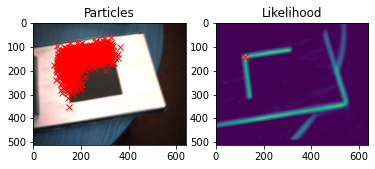

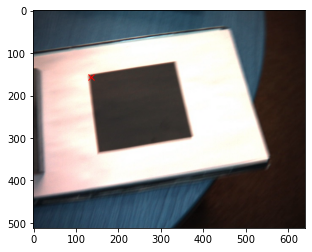

Processing Frame 111
[129.02919748 165.48804153]
Processing Frame 112
[124.30994902 172.02453656]
Processing Frame 113
[122.38571752 175.52444438]
Processing Frame 114
[125.21532925 176.56330414]
Processing Frame 115
[129.20232686 182.90683141]
Processing Frame 116
[133.60753209 182.1300723 ]
Processing Frame 117
[138.10374104 185.52147095]
Processing Frame 118
[142.56579142 187.67276589]
Processing Frame 119
[151.88349906 185.06051392]
Processing Frame 120
[158.14320775 187.23829468]


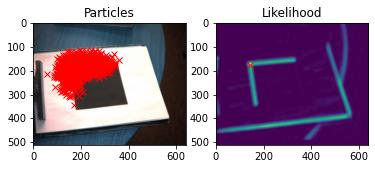

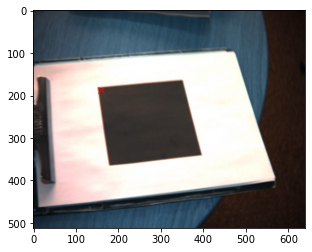

Processing Frame 121
[162.52285843 187.1230869 ]
Processing Frame 122
[165.07096692 183.56227619]
Processing Frame 123
[167.94034434 177.30126172]
Processing Frame 124
[165.93560214 181.32047127]
Processing Frame 125
[159.29437744 181.26953928]
Processing Frame 126
[164.88891183 179.05185873]
Processing Frame 127
[171.79484619 173.87795038]
Processing Frame 128
[174.08514465 176.03027551]
Processing Frame 129
[176.90579698 178.5785961 ]
Processing Frame 130
[173.96822982 182.02625129]


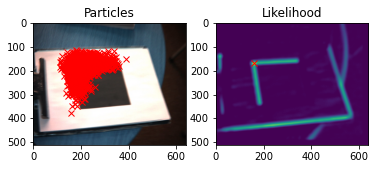

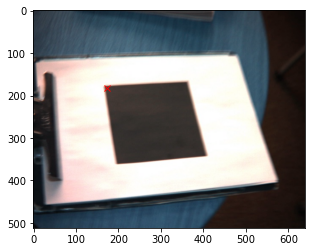

Processing Frame 131
[163.64296344 181.06837355]
Processing Frame 132
[157.51443926 173.377188  ]
Processing Frame 133
[157.47804108 162.01054578]
Processing Frame 134
[155.18793193 156.56816556]
Processing Frame 135
[156.92842885 148.76801324]
Processing Frame 136
[159.83940073 145.99631855]
Processing Frame 137
[159.61791647 138.88354781]
Processing Frame 138
[158.39567392 137.32819805]
Processing Frame 139
[164.17232267 133.52829203]
Processing Frame 140
[169.32040511 133.30437718]


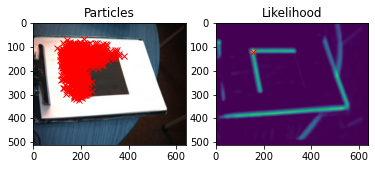

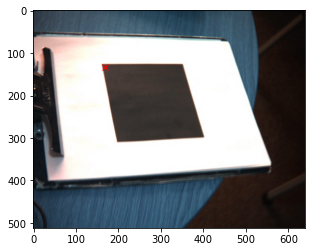

Processing Frame 141
[167.11204469 135.87075118]
Processing Frame 142
[166.40800544 133.24297952]
Processing Frame 143
[160.91004158 132.05505813]
Processing Frame 144
[154.27332169 135.7921277 ]
Processing Frame 145
[147.77211016 132.15865978]
Processing Frame 146
[144.46221086 124.54076339]
Processing Frame 147
[140.64742796 131.14861175]
Processing Frame 148
[134.34436662 134.59078326]
Processing Frame 149
[134.76244752 136.75822216]
Processing Frame 150
[134.84371623 135.54921391]


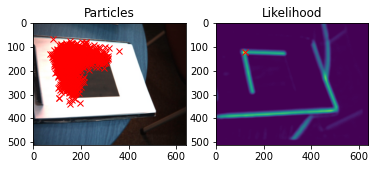

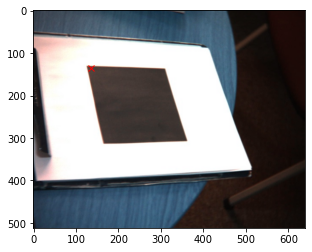

In [6]:

ULs = HW2_Practical7c( 'ul', plotRate=10)


We are matching this template with shape:  (28, 30)


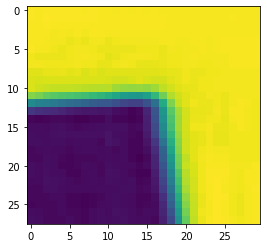

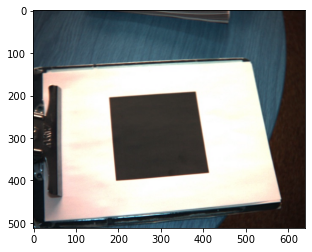

Processing Frame 0
[386.20165999 196.6700085 ]


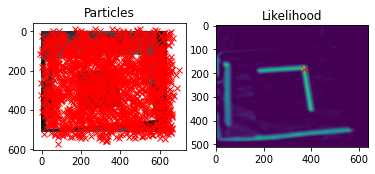

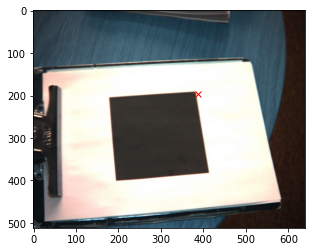

Processing Frame 1
[381.16806416 196.41446456]
Processing Frame 2
[382.43996244 192.57279566]
Processing Frame 3
[384.71385042 197.6169297 ]
Processing Frame 4
[385.55933383 200.03882526]
Processing Frame 5
[385.4249583  197.42093035]
Processing Frame 6
[389.12464966 196.80470934]
Processing Frame 7
[390.59779114 196.82971209]
Processing Frame 8
[391.24785443 198.53348191]
Processing Frame 9
[394.09769633 197.97296073]
Processing Frame 10
[393.81969414 199.2148375 ]


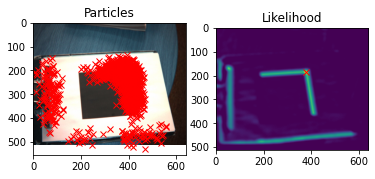

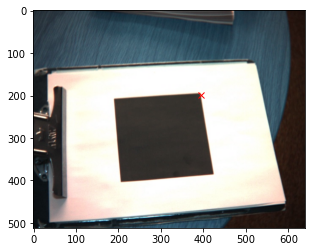

Processing Frame 11
[391.39538027 201.4718675 ]
Processing Frame 12
[390.46409408 199.60481529]
Processing Frame 13
[391.03781661 198.12455068]
Processing Frame 14
[397.49569896 190.17952275]
Processing Frame 15
[402.96695381 184.86694388]
Processing Frame 16
[408.81341976 179.4934515 ]
Processing Frame 17
[410.39722661 179.93976681]
Processing Frame 18
[415.40167608 179.3131201 ]
Processing Frame 19
[420.35045229 179.74688932]
Processing Frame 20
[424.0487035 182.5612398]


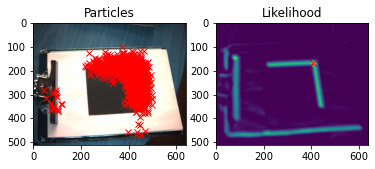

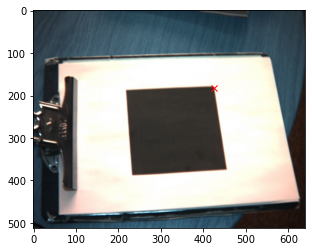

Processing Frame 21
[427.93054888 186.59730191]
Processing Frame 22
[430.6610158  189.68647385]
Processing Frame 23
[437.22083017 192.98699974]
Processing Frame 24
[442.59108182 192.33132308]
Processing Frame 25
[446.70385438 192.43582012]
Processing Frame 26
[453.21995017 191.84492502]
Processing Frame 27
[458.68923667 187.81406861]
Processing Frame 28
[468.47587671 186.5546321 ]
Processing Frame 29
[473.28517443 188.67322658]
Processing Frame 30
[477.82489892 191.07269806]


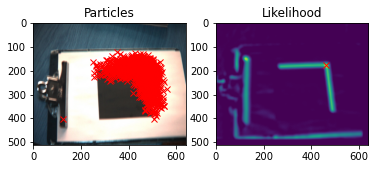

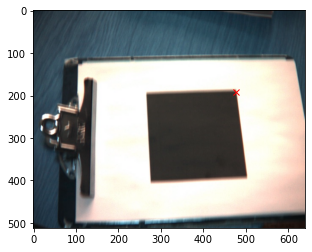

Processing Frame 31
[475.06096992 200.69986267]
Processing Frame 32
[475.51916576 206.24656463]
Processing Frame 33
[475.5359491  214.50781249]
Processing Frame 34
[473.13688031 218.52864857]
Processing Frame 35
[466.51777151 221.16028423]
Processing Frame 36
[456.05827373 218.50032574]
Processing Frame 37
[444.69011494 212.86991776]
Processing Frame 38
[426.03679343 208.54981293]
Processing Frame 39
[414.16142289 211.95234679]
Processing Frame 40
[398.53019134 220.46381144]


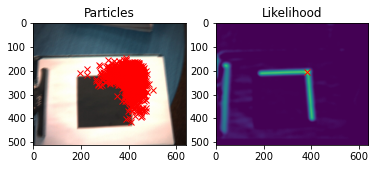

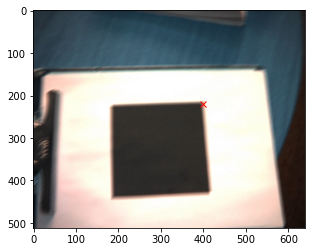

Processing Frame 41
[389.95502622 231.75541022]
Processing Frame 42
[385.39642618 239.64355438]
Processing Frame 43
[374.02157738 252.35554603]
Processing Frame 44
[370.41976891 262.41812207]
Processing Frame 45
[369.70351917 269.8477138 ]
Processing Frame 46
[368.15026976 272.92929759]
Processing Frame 47
[372.02867604 267.79962083]
Processing Frame 48
[372.25030206 263.06287821]
Processing Frame 49
[374.21234727 252.9254401 ]
Processing Frame 50
[375.01348665 243.11720554]


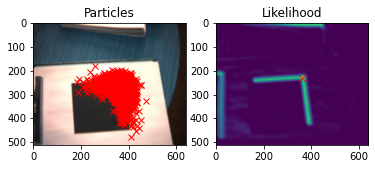

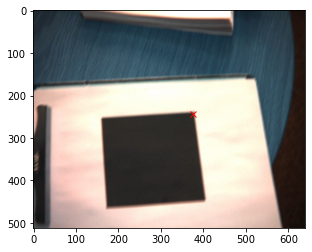

Processing Frame 51
[380.04390759 236.72554532]
Processing Frame 52
[381.62226336 234.25775556]
Processing Frame 53
[379.82396934 237.61159237]
Processing Frame 54
[379.77591971 239.13428636]
Processing Frame 55
[374.6131955  243.70028471]
Processing Frame 56
[372.38982021 242.91065405]
Processing Frame 57
[373.84664048 234.25202394]
Processing Frame 58
[373.55556911 221.79907367]
Processing Frame 59
[375.55480196 210.60919635]
Processing Frame 60
[373.78226695 194.16845891]


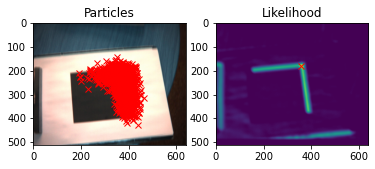

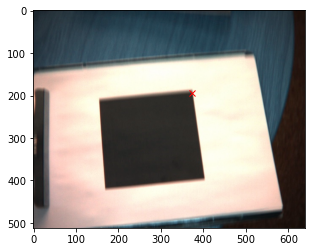

Processing Frame 61
[371.71946271 186.37817819]
Processing Frame 62
[373.47283242 179.50068133]
Processing Frame 63
[370.20360579 177.28469271]
Processing Frame 64
[368.98176419 176.22369714]
Processing Frame 65
[369.58494375 172.60493541]
Processing Frame 66
[368.65019309 172.22437117]
Processing Frame 67
[366.95602931 170.63220911]
Processing Frame 68
[366.57720349 169.6403003 ]
Processing Frame 69
[365.37351836 165.16997975]
Processing Frame 70
[364.83648222 163.04038212]


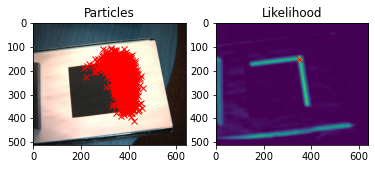

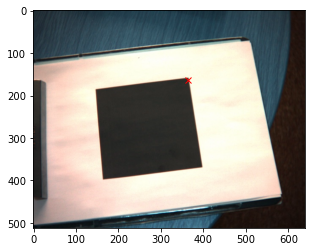

Processing Frame 71
[364.4334086  162.32412185]
Processing Frame 72
[365.05758021 161.69004286]
Processing Frame 73
[365.88959522 159.57675002]
Processing Frame 74
[365.79013861 162.92485307]
Processing Frame 75
[367.18507868 163.74505407]
Processing Frame 76
[374.58792991 170.35751526]
Processing Frame 77
[385.77689688 166.58660118]
Processing Frame 78
[403.86338123 156.22220281]
Processing Frame 79
[406.05758342 150.12221213]
Processing Frame 80
[412.89690008 136.57713896]


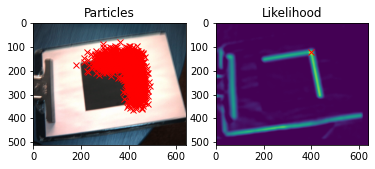

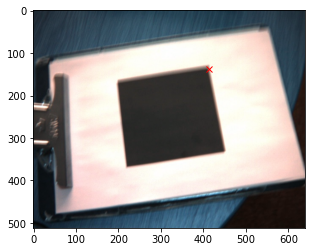

Processing Frame 81
[415.4795529  129.96111675]
Processing Frame 82
[416.52487315 125.26456665]
Processing Frame 83
[413.48975797 120.42521732]
Processing Frame 84
[412.96251313 117.17332513]
Processing Frame 85
[411.88109298 114.1091898 ]
Processing Frame 86
[409.27181442 113.30551996]
Processing Frame 87
[403.91366215 114.32774923]
Processing Frame 88
[399.72603703 110.62927041]
Processing Frame 89
[394.24648464 110.40666141]
Processing Frame 90
[393.66665658 109.59494613]


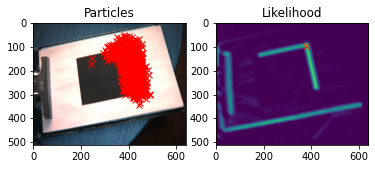

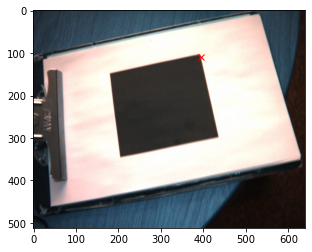

Processing Frame 91
[391.13147965 106.4774071 ]
Processing Frame 92
[390.55857176 106.74959557]
Processing Frame 93
[391.21183697 101.42183325]
Processing Frame 94
[392.34170825 100.76705051]
Processing Frame 95
[391.83655197  98.59694689]
Processing Frame 96
[389.74205663 101.50749   ]
Processing Frame 97
[375.59299109 109.20178804]
Processing Frame 98
[365.93157388 117.60363199]
Processing Frame 99
[361.8218025  124.86420806]
Processing Frame 100
[354.92728077 137.60083856]


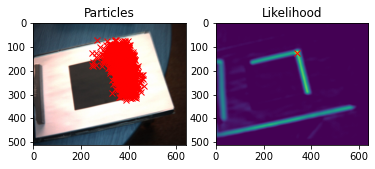

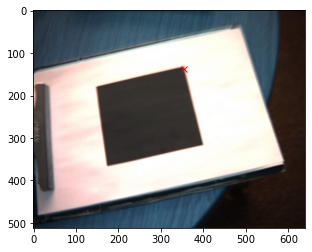

Processing Frame 101
[351.76555824 139.39406703]
Processing Frame 102
[345.87955268 142.64581379]
Processing Frame 103
[344.19782184 134.57515978]
Processing Frame 104
[346.56053577 129.72661736]
Processing Frame 105
[339.37039473 131.15809861]
Processing Frame 106
[341.82986666 125.57290111]
Processing Frame 107
[342.27948425 122.41795813]
Processing Frame 108
[340.19281244 122.98026957]
Processing Frame 109
[341.00851054 123.09859042]
Processing Frame 110
[332.83989208 125.69893123]


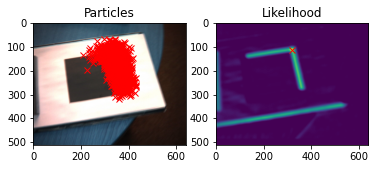

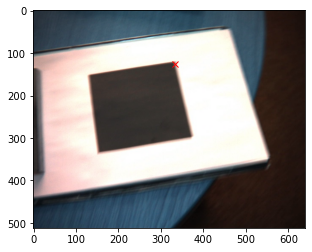

Processing Frame 111
[326.35717344 137.88194257]
Processing Frame 112
[319.27318441 147.90021145]
Processing Frame 113
[318.14633635 150.21544219]
Processing Frame 114
[320.65328634 153.63776741]
Processing Frame 115
[322.06696589 161.63151588]
Processing Frame 116
[327.03646992 162.25574776]
Processing Frame 117
[332.2564851  167.32034118]
Processing Frame 118
[336.54848099 167.65587913]
Processing Frame 119
[344.0366451  165.55165395]
Processing Frame 120
[351.02606471 168.66174271]


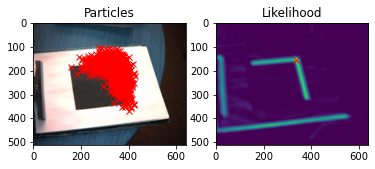

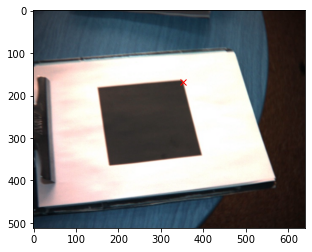

Processing Frame 121
[354.43810593 171.521772  ]
Processing Frame 122
[357.49202151 167.291419  ]
Processing Frame 123
[361.93677567 163.99849036]
Processing Frame 124
[356.00381998 166.34144772]
Processing Frame 125
[352.45073072 167.09730949]
Processing Frame 126
[358.06583355 165.52014064]
Processing Frame 127
[361.87395785 162.20948279]
Processing Frame 128
[364.99423905 165.57382917]
Processing Frame 129
[365.53988114 166.57519349]
Processing Frame 130
[362.88918118 172.153579  ]


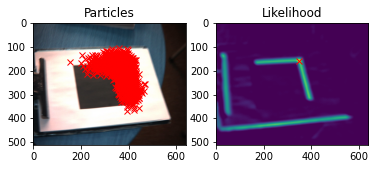

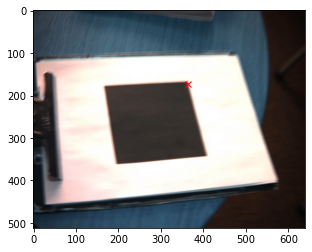

Processing Frame 131
[351.34449364 172.36853698]
Processing Frame 132
[344.60274244 164.44848227]
Processing Frame 133
[345.2027331  154.55388125]
Processing Frame 134
[343.37449595 149.62805022]
Processing Frame 135
[342.5408418  144.21336555]
Processing Frame 136
[345.09959479 139.42979254]
Processing Frame 137
[343.62027053 134.84491555]
Processing Frame 138
[341.92055948 133.9659597 ]
Processing Frame 139
[348.84208142 132.42104717]
Processing Frame 140
[351.10664901 130.59668334]


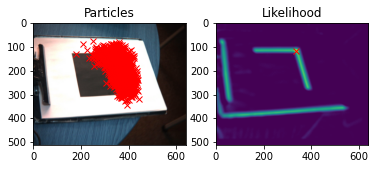

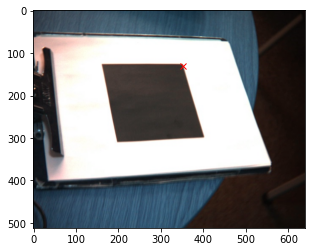

Processing Frame 141
[349.67518204 134.66615929]
Processing Frame 142
[346.78235483 133.34764539]
Processing Frame 143
[343.37999066 133.27814148]
Processing Frame 144
[336.28078201 135.910512  ]
Processing Frame 145
[329.50208396 132.7631002 ]
Processing Frame 146
[324.77156381 126.36206755]
Processing Frame 147
[318.78685271 135.35426809]
Processing Frame 148
[311.66152962 137.9692758 ]
Processing Frame 149
[312.41042267 142.53168113]
Processing Frame 150
[309.69947426 141.69404961]


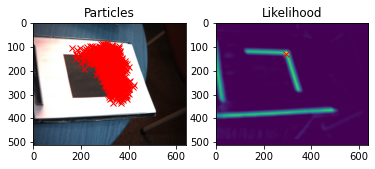

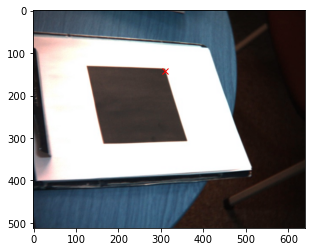

In [7]:
URs = HW2_Practical7c( 'ur', plotRate=10)

As we can see above from the plots, the likelihood does seem to shine brightest around the corners we're trying to track however the MAP tracked particle doesn't coincide with the needed corner perfectly thus though we have good tracking of the corners it is far from perfect.

In [8]:
#practical2b functions
def projectiveCamera(K,T,XCart):
    ##TODO
    # The goal of this function is to project points in XCart through projective camera
    # defined by intrinsic matrix K and extrinsic matrix T. In essence, this function takes a set of points 
    # in 3D world space, XCart, and projects them into camera image space by applying the extrinsic matrix T 
    # and then applying the intrinsic matrix K.
    # 
    # There are three steps.
    # 1) Move from world space to camera space. 
    #            camera space points = extrinsics T * world space points 
    #
    # 2) Applying the intrinsics matrix to the camera space points after normalizing
    #           homogeneous image space points = K * normalized camera space points
    # 
    # 3) Move to image space cartesian points from image space homogeneous points, involves a 
    # normalization using the third row.
    
    
    # TODO: Replace this
    XImCart = []

    # TODO: Convert Cartesian 3d points XCart to homogeneous coordinates XHom
    XHom = np.concatenate((XCart, np.ones((1,XCart.shape[1]))), axis=0);
    # TODO: Apply extrinsic matrix to XHom, to move to frame of reference of camera
    xCamHom = np.matmul(T,XHom);
    # TODO: Project points into normalized camera coordinates xCamHom (remove 4th row)
    xCamHom = xCamHom[0:3, :];
    # TODO: Move points to image coordinates xImHom by applying intrinsic matrix
    xCamHom = np.matmul(K,xCamHom);
    # TODO: Convert points back to Cartesian coordinates xImCart
    XImCart = xCamHom[0:2,:] / np.tile([xCamHom[2,:]],(2,1));
    return XImCart

def solveAXEqualsZero(A):
    # TODO: Write this routine - it should solve Ah = 0. You can do this using SVD. Consult your notes! 
    # Hint: SVD will be involved. 
    U, L, VT = np.linalg.svd(A)
    V = VT.T
    h = V[:,-1]
    return h

def calcBestHomography(pts1Cart, pts2Cart):
    
    # This function should apply the direct linear transform (DLT) algorithm to calculate the best 
    # homography that maps the cartesian points in pts1Cart to their corresonding matching cartesian poitns 
    # in pts2Cart.
    
    # This function calls solveAXEqualsZero. Make sure you are wary of how to reshape h into a 3 by 3 matrix. 

    n_points = pts1Cart.shape[1]
    
    # TODO: replace this:
    H = np.identity(3)

    # TODO: 
    # First convert points into homogeneous representation
    # Hint: we've done this before  in the skeleton code we provide.
    pts1Hom = np.concatenate((pts1Cart, np.ones((1,pts1Cart.shape[1]))), axis=0)
    pts2Hom = np.concatenate((pts2Cart, np.ones((1,pts2Cart.shape[1]))), axis=0)
    
    # Then construct the matrix A, size (n_points * 2, 9)
    # Consult the notes!
    n_points = pts1Cart.shape[1]

    A = np.zeros((2*n_points,9))
    
    for point in range(n_points):
        #first row in each pair of rows of A
        A[2*point, 3:6] = -1*pts1Hom[:,point]
        A[2*point, 6:9] = pts2Hom[1,point]*pts1Hom[:,point]

        #second row in each pair of rows of A
        A[2*point + 1, 0:3] = pts1Hom[:,point]
        A[2*point + 1, 6:9] = -1*pts2Hom[0,point]*pts1Hom[:,point]



    # Solve Ah = 0 using solveAXEqualsZero and get h.
    h = solveAXEqualsZero(A)
    # Reshape h into the matrix H, values of h go first into rows of H
    H = np.reshape(h, (3,3))
    
    return H

def estimatePlanePose(XImCart,XCart,K):
    # The goal of this function is to estimate the pose of a plane relative to camera (extrinsic matrix)
    # given points in image space xImCart, points in 3D world space XCart, and an intrinsics matrix K.
    
    # TODO: replace this
    T = np.zeros((4,4))

    # TODO: Convert Cartesian image points XImCart to homogeneous representation XImHom
    XImHom = np.concatenate((XImCart, np.ones((1,XImCart.shape[1]))), axis=0)
    
    # TODO: Convert image co-ordinates XImHom to normalized camera coordinates XCamHom    
    XCamHom = np.matmul(np.linalg.inv(K),XImHom)
    
    # TODO: Estimate homography H mapping homogeneous (x,y) coordinates of positions
    # in real world to XCamHom (convert XCamHom to Cartesian, calculate the homography) -
    # use the routine you wrote for Practical 1B

    XCamHomCart = XCamHom[0:2,:] / np.tile([XCamHom[2,:]],(2,1))
    H = calcBestHomography(XCart[0:2,:],XCamHomCart)
          
    # TODO: Estimate first two columns of rotation matrix R from the first two
    # columns of H using the SVD. NOTE: You do not need to transpose v from linalg.svd    
    U, L, VT = np.linalg.svd(H[:,:2])
    I = np.eye(3)
    R = I.copy()
    R[:,:2] = U @ I[:,:2] @ VT

    # TODO: Estimate the third column of the rotation matrix by taking the cross
    # product of the first two columns
    R[:,2] = np.cross(R[:,0],R[:,1])
        
    # TODO: Check that the determinant of the rotation matrix is positive - if
    # not then multiply last column by -1.
    if(np.linalg.det(R)<=0):
        R[:,2] = R[:,2] * -1
    
    # TODO: Estimate the translation t by finding the appropriate scaling factor k
    # and applying it to the third colulmn of H
    k = np.sum(H[:,:2]/R[:,:2])/6
    t = H[:,[-1]]/k
    # TODO: Check whether t_z is negative - if it is then multiply t by -1 and
    # the first two columns of R by -1.
    if(t[-1,:]<0):
        t = t * -1
        R[:,:2] = R[:,:2] * -1
            
    # TODO: Assemble transformation into matrix form
    T[:-1, :-1] = R
    T[:-1, [-1]] = t
    T[-1,-1] = 1
    return T



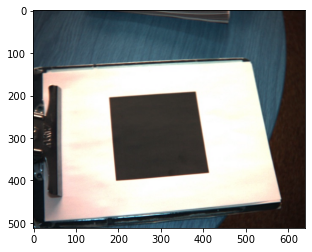

In [9]:
# Load all images in folder
images = []
nFrame = 0
folder = 'Pattern01/'
lst = os.listdir(folder)
lst.sort()

for frameNum in lst:
    images.append(cv.imread(folder+frameNum))
    nFrame += 1
# plot first image 
plt.imshow(images[0])
plt.show()


# Coordinates of the known target object (a dark square on a plane) in 3D:
XCart = np.array([[-50, -50,  50,  50],
          [50, -50, -50,  50],
            [0, 0, 0, 0]])

# These are some approximate intrinsics for this footage.
K = np.array([[640, 0, 320],
          [0, 512, 256],
            [0, 0, 1]])

# Define 3D points of wireframe object.
XWireFrameCart = np.array([[-50, -50,  50,  50, -50, -50,  50,  50],
          [50, -50, -50,  50, 50, -50, -50,  50],
            [0, 0, 0, 0, -100, -100, -100, -100, ]])

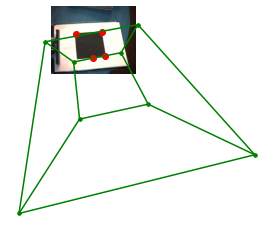

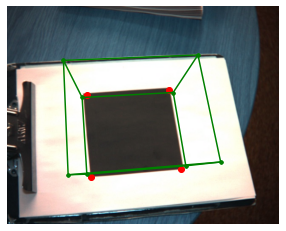

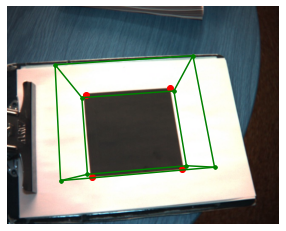

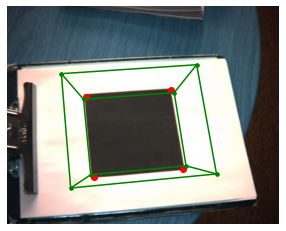

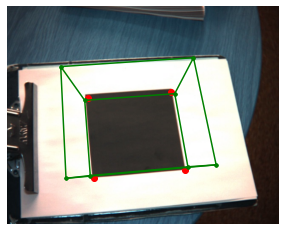

...

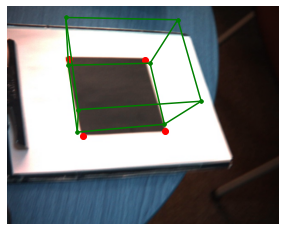

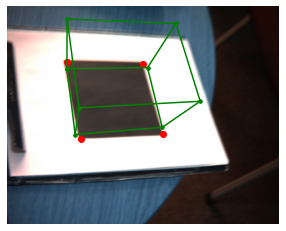

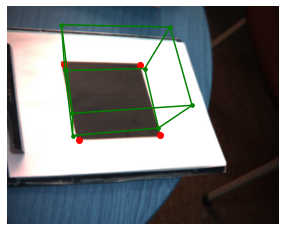

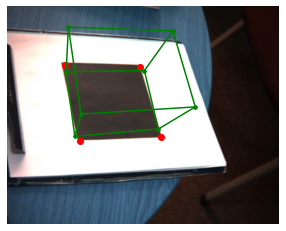

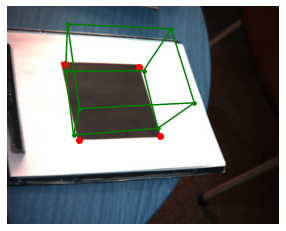

In [10]:
# ================================================
for iFrame in range(nFrame):
    xImCart = np.array([LLs[iFrame,:].T, ULs[iFrame,:].T, URs[iFrame,:].T, LRs[iFrame,:].T]).T

    # get a frame from footage 
    im = images[iFrame]

    # Draw image and 2d points
    plt.imshow(im)
    plt.scatter(x = xImCart[0,:], y = xImCart[1,:],c = 'r')
    #plt.show()

    
    #TODO: Use your routine to calculate TEst the extrinsic matrix relating the
    #plane position to the camera position.
    T = estimatePlanePose(xImCart, XCart, K);

    
    # TODO: Draw a wire frame cube using data XWireFrameCart. You need to
    # 1) project the vertices of a 3D cube through the projective camera;
    XWireFrameCartProjected = projectiveCamera(K,T,XWireFrameCart)
    # 2) draw lines betweeen the resulting 2d image points.
    for index in range(4):
        #edges in bottom square
        v1 = XWireFrameCartProjected[:,index]
        v2 = XWireFrameCartProjected[:,(index+1)%4]
        x = [v1[0], v2[0]]
        y = [v1[1], v2[1]]
        plt.plot(x, y, 'g.', linestyle="-")

        #edges in top square
        v1 = XWireFrameCartProjected[:,index+4]
        v2 = XWireFrameCartProjected[:,(index+1)%4 + 4]
        x = [v1[0], v2[0]]
        y = [v1[1], v2[1]]
        plt.plot(x, y, 'g.', linestyle="-")

        #edges between top and bottom square
        v1 = XWireFrameCartProjected[:,index]
        v2 = XWireFrameCartProjected[:,index+4]
        x = [v1[0], v2[0]]
        y = [v1[1], v2[1]]
        plt.plot(x, y, 'g.', linestyle="-")
    plt.axis('off')
    plt.show()
    # Note: CONDUCT YOUR CODE FOR DRAWING XWireFrameCart HERE
    


From what I can see, the worst performance of the estimatepose routine seems to be from very angled perspectives of the square where we get really close to the square and look on from either side of it.
As we can see our estimated green points do not match up with the red tracked points which leads to a poor looking cube and at times completely off. I believe this is because we made use of the DLT so we didn't solve the problem we were supposed to solve but an alternative one. Thus our solutions are good initilisations to look for the true solutions in a non-linear optimisation space however they are not perfect on their own. Thus one improvement would be to start from these solutions and try to solve the actual problem with a non-linear optimiser.
Another improvement would come from the particles tracking the corners. These are often inaccurate and find false matches(with the clipboard or paper edge) in the image, thus we could make the patch that we're meauring the similarity for more unique for each corner so that we can reduce these false matches and concentrate the high likelihood values in more appropriate regions.

